In [1]:
import numpy as np
import matplotlib.pyplot as plt
import random

[4.51805026e+000 2.58631883e+000 1.45026554e-001 ... 4.48196903e-137
 1.40726719e-136 6.52349723e-136]


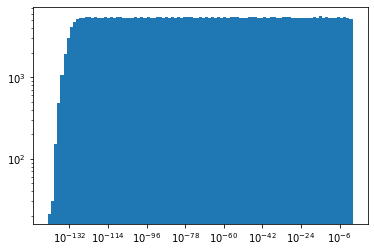

In [2]:
iteration = 500
numSteps = 1000
initMass = 10
masses = np.array([initMass])
fullMass = np.array([])
idx = 0
param = 1

for i in range(iteration):
    for j in range(numSteps):
        split = random.uniform(0,1)
        masses = np.append(masses, masses[idx] * (1-split))
        masses[idx] = masses[idx] * split
        if random.uniform(0,1) < param:
            if split < 0.5:
                idx = len(masses) - 1
        else:
            if split > 0.5:
                idx = len(masses) - 1
    fullMass = np.append(fullMass, masses)
    masses = np.array([initMass])
    idx = 0

print(fullMass)
logbins = np.logspace(np.log10(min(fullMass)), np.log10(1.0), 100)

plt.hist(fullMass, bins=logbins)
plt.xscale('log')
plt.yscale('log')
plt.show()





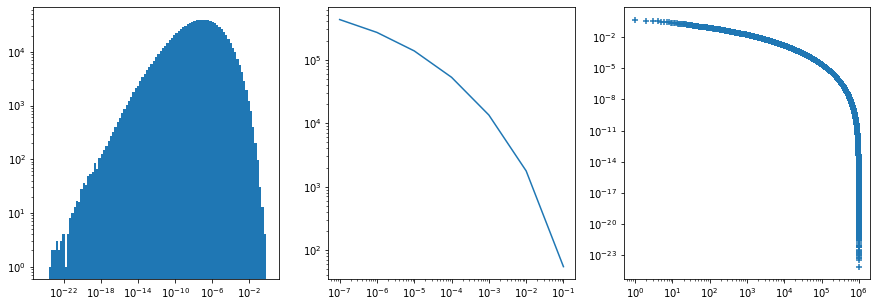

In [3]:
iteration = 10**2
numSteps = 10**4
initMass = 1
masses = np.array([initMass])
fullMass = np.array([])
idx = 0

fig, ax = plt.subplots(1,3,figsize=(15,5))
for i in range(iteration):
    for j in range(numSteps):
        idx = random.randint(0,len(masses)-1)
        split = random.uniform(0,1)
        masses = np.append(masses, masses[idx] * (1-split))
        masses[idx] = masses[idx] * split
    fullMass = np.append(fullMass, masses)
    masses = np.array([initMass])
    idx = 0

logbins = np.logspace(np.log10(min(fullMass)), np.log10(1.0), 100)
n, bins, patches = ax[0].hist(fullMass, bins=logbins)
ax[0].set_xscale('log')
ax[0].set_yscale('log')
plot_size = int(np.log10(numSteps*1000)) # factor adds OOM to the plots
plot_x = [0]*plot_size
plot_y = [0]*plot_size
plot_count = 0
# print(sum(sim_space)) # check
while plot_count < plot_size:
    plot_power = 1/(10**(plot_count+1))
    plot_x[plot_count] = plot_power
    plot_y[plot_count] = len([i for i in fullMass if i > plot_power]) # https://www.geeksforgeeks.org/python-number-of-values-greater-than-k-in-list/
    plot_count+=1

# plotting log-log
ax[1].set_xscale('log')
ax[1].set_yscale('log')
ax[1].plot(plot_x, plot_y)

ccdf = np.sort(fullMass)[::-1]
ranks = np.arange(1, len(ccdf)+1)

ax[2].scatter(ranks, ccdf, marker='+')
ax[2].set_xscale('log')
ax[2].set_yscale('log')

    
def calc_alpha(amount, xmin, xmax):
    alpha = 1 + len(amount[xmin:xmax]) / (np.sum(np.log(amount[xmin:xmax]/ (np.min(amount[xmin:xmax]) - 0.5))))
    sigma = (alpha - 1) / np.sqrt(len(amount[xmin:xmax]))
    return [alpha, sigma]

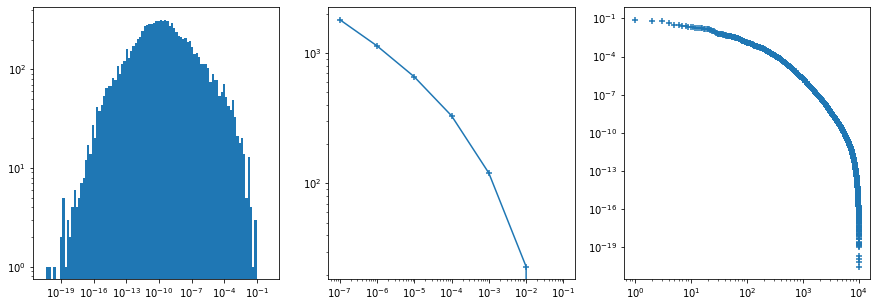

In [4]:
fig, ax = plt.subplots(1,3,figsize=(15,5))
# setup space
sim_size = 10**4
sim_space = [0]*sim_size
sim_count = 0
sim_space[sim_count] = 1
# print(sim_space) # check

# fraction space for one out of simcount+1 elements
while sim_count < sim_size-1:
    rnd_position = random.randint(0,sim_count)
    rnd_fraction = random.random()
    sim_space[sim_count+1]  = sim_space[rnd_position]*(1-rnd_fraction)
    sim_space[rnd_position] = sim_space[rnd_position]*rnd_fraction
    sim_count+=1
    # print(sim_space) # check

# check
ax[0].set_xscale('log')
ax[0].set_yscale('log')
logbins = np.logspace(np.log10(min(sim_space)), np.log10(1.0), 100)
ax[0].hist(sim_space, bins=logbins)

plot_size = int(np.log10(sim_size*1000)) # factor adds OOM to the plots
plot_x = [0]*plot_size
plot_y = [0]*plot_size
plot_count = 0
# print(sum(sim_space)) # check
while plot_count < plot_size:
    plot_power = 1/(10**(plot_count+1))
    plot_x[plot_count] = plot_power
    plot_y[plot_count] = len([i for i in sim_space if i > plot_power]) # https://www.geeksforgeeks.org/python-number-of-values-greater-than-k-in-list/
    plot_count+=1

# plotting log-log
ax[1].set_xscale('log')
ax[1].set_yscale('log')
ax[1].plot(plot_x, plot_y)
ax[1].scatter(plot_x, plot_y, marker='+')

ccdf = np.sort(sim_space)[::-1]
ranks = np.arange(1, len(ccdf)+1)

ax[2].scatter(ranks, ccdf, marker='+')
ax[2].set_xscale('log')
ax[2].set_yscale('log')
# output for one run:
# [0.1, 0.01, 0.001, 0.0001, 1e-05, 1e-06, 1e-07, 1e-08, 1e-09]
# [1, 13, 129, 831, 4154, 15869, 44950, 101325, 190545]

[3.616468902295709e-11, 1.746188954396652e-10, 7.197584654823759e-09, 1.6394761282303932e-09, 1.732201567568525e-11, 6.046991009483134e-12, 3.6042798003680376e-10, 4.042606447042957e-10, 5.346367382118515e-10, 3.539004455966565e-09, 9.892765442350196e-10, 5.569448521338284e-09, 4.249877867082176e-11, 6.413454239086229e-10, 2.17913229477218e-09, 1.2394984905116673e-09, 1.336502114446419e-10, 1.2713698490434641e-09, 5.268120551404834e-10, 9.265085816002813e-11, 1.8135062632993007e-10, 4.704907553991107e-10, 8.235495659818398e-11, 1.1519847776486204e-09, 2.2533329238428006e-09, 4.84741673711587e-09, 1.4503215712077223e-09, 4.7264611820066355e-11, 2.670650932853672e-09, 5.430870581254879e-10, 5.401798787672991e-10, 8.598828055618029e-09, 1.6157409861127574e-10, 9.160871458041433e-09, 7.398259284931935e-09, 4.452948715446559e-10, 4.721309102835132e-10, 2.7953075916185277e-10, 1.0172116961269195e-09, 2.4543283351688415e-09, 1.4687871736701446e-08, 5.557200191753907e-09, 6.34183853193551e-10,

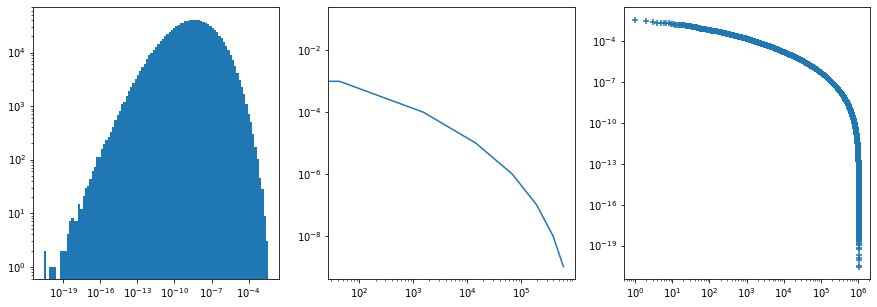

In [5]:
fig, ax = plt.subplots(1,3,figsize=(15,5))
curr_mass = []
next_mass = []
numSteps = 20
initMass = 1
curr_mass.append(initMass)
for i in range(numSteps):
    for j in range(len(curr_mass)):
        split = random.uniform(0,1)
        next_mass.append(curr_mass[j] * (1-split))
        next_mass.append(curr_mass[j] * split)
    curr_mass = next_mass
    next_mass = []   
print(curr_mass)
ax[0].set_xscale('log')
ax[0].set_yscale('log')
logbins = np.logspace(np.log10(min(curr_mass)), np.log10(max(curr_mass)), 100)
ax[0].hist(curr_mass, bins=logbins)

plot_size = int(np.log10(2**numSteps *1000)) # factor adds OOM to the plots
plot_x = [0]*plot_size
plot_y = [0]*plot_size
plot_count = 0
# print(sum(sim_space)) # check
while plot_count < plot_size:
    plot_power = 1/(10**(plot_count+1))
    plot_x[plot_count] = plot_power
    plot_y[plot_count] = len([i for i in curr_mass if i > plot_power]) # https://www.geeksforgeeks.org/python-number-of-values-greater-than-k-in-list/
    plot_count+=1

# plotting log-log
ax[1].set_xscale('log')
ax[1].set_yscale('log')
ax[1].plot(plot_y, plot_x)

ccdf = np.sort(curr_mass)[::-1]
ranks = np.arange(1, len(ccdf)+1)

ax[2].scatter(ranks, ccdf, marker='+')
ax[2].set_xscale('log')
ax[2].set_yscale('log')


(array([1.000e+00, 3.000e+00, 1.000e+00, 2.000e+00, 1.000e+00, 3.000e+00,
        6.000e+00, 5.000e+00, 4.000e+00, 3.000e+00, 2.000e+00, 8.000e+00,
        7.000e+00, 9.000e+00, 1.300e+01, 1.600e+01, 2.100e+01, 2.200e+01,
        2.400e+01, 3.300e+01, 4.900e+01, 3.200e+01, 4.000e+01, 5.700e+01,
        5.600e+01, 8.800e+01, 1.070e+02, 9.600e+01, 1.450e+02, 1.410e+02,
        2.030e+02, 2.060e+02, 2.440e+02, 2.880e+02, 2.820e+02, 3.570e+02,
        4.280e+02, 5.030e+02, 4.920e+02, 5.940e+02, 6.160e+02, 7.260e+02,
        8.600e+02, 9.270e+02, 1.058e+03, 1.167e+03, 1.213e+03, 1.427e+03,
        1.529e+03, 1.662e+03, 1.880e+03, 1.880e+03, 2.113e+03, 2.215e+03,
        2.289e+03, 2.442e+03, 2.590e+03, 2.792e+03, 2.881e+03, 3.055e+03,
        3.193e+03, 3.211e+03, 3.275e+03, 3.268e+03, 3.415e+03, 3.393e+03,
        3.412e+03, 3.102e+03, 3.074e+03, 3.110e+03, 3.005e+03, 2.765e+03,
        2.701e+03, 2.464e+03, 2.316e+03, 2.169e+03, 1.942e+03, 1.763e+03,
        1.583e+03, 1.297e+03, 1.174e+0

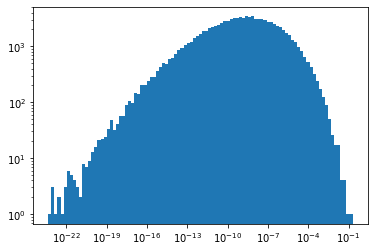

In [6]:
simSpace = []
for i in range(10**5):
    simSpace.append(random.uniform(0,1))
numSteps = 10**6
numIterations = 1
for i in range(numIterations):
    for i in range(numSteps):
        split = random.uniform(0,1)
        int1 = random.randint(0,len(simSpace)-1)
        int2 = random.randint(0,len(simSpace)-1)
        simSpace[int1] = simSpace[int1] * split
        simSpace[int2] = simSpace[int2] * (1-split)

plt.xscale('log')
plt.yscale('log')

logbins = np.logspace(np.log10(min(simSpace)), np.log10(max(simSpace)), 100)
plt.hist(simSpace, bins=logbins)

